In [1]:
import pandas as pd
import numpy as np

from sklearn.preprocessing import StandardScaler

from sklearn.linear_model import Ridge,Lasso,RidgeCV, LassoCV, ElasticNet, ElasticNetCV, LogisticRegression
from sklearn.model_selection import train_test_split

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score

import matplotlib.pyplot as plt

import seaborn as sns
from pandas_profiling import ProfileReport
import pickle

In [3]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [5]:
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [6]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
df['BMI'] = df['BMI'].replace(0, df['BMI'].mean())

In [9]:
df['BloodPressure'] = df['BloodPressure'].replace(0, df['BloodPressure'].mean())

In [10]:
df['Insulin'] = df['Insulin'].replace(0, df['Insulin'].mean())

In [11]:
df['Glucose'] = df['Glucose'].replace(0, df['Glucose'].mean())

In [12]:
df['SkinThickness'] = df['SkinThickness'].replace(0, df['SkinThickness'].mean())

In [13]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

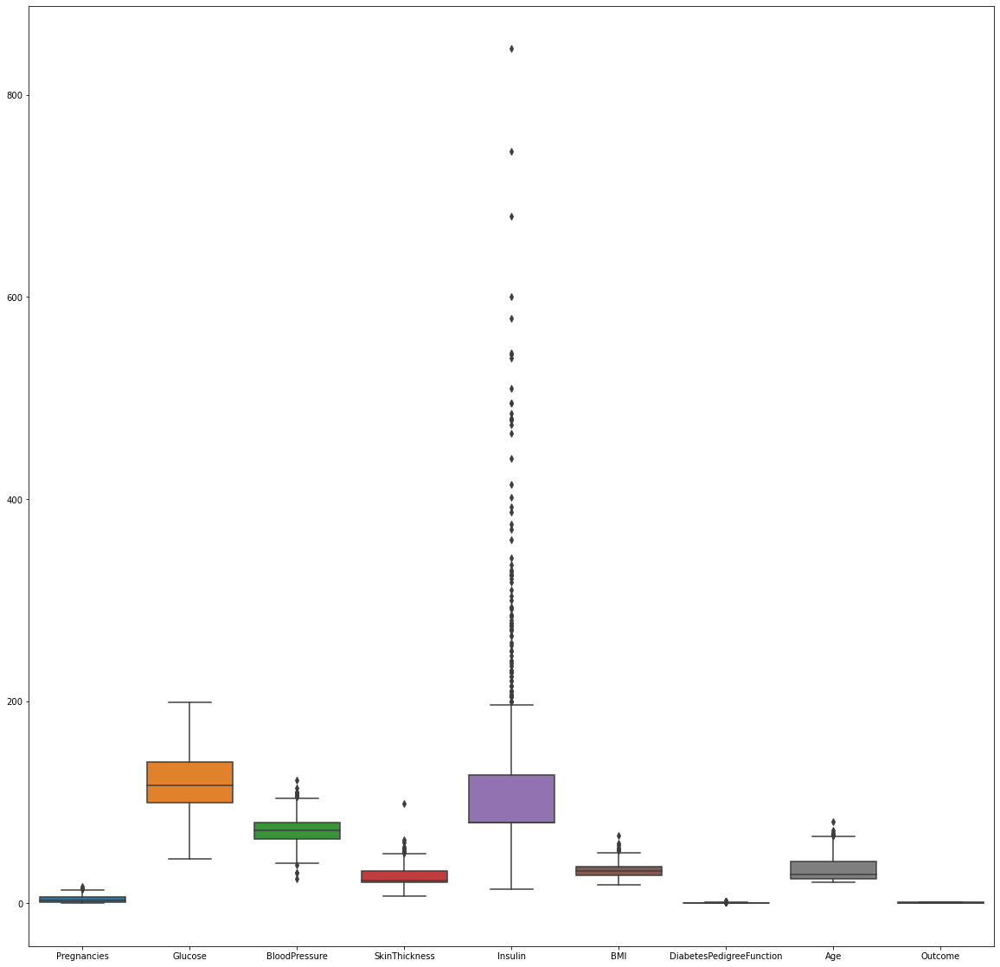

In [14]:
fig ,ax = plt.subplots(figsize = (20,20))
sns.boxplot(data=df, ax=ax)

In [18]:
q = df['Insulin'].quantile(.95)
df_new = df[df['Insulin'] < q]

q = df_new['BMI'].quantile(.99)
df_new = df_new[df_new['BMI'] < q]

q = df_new['SkinThickness'].quantile(.99)
df_new = df_new[df_new['SkinThickness'] < q]

q = df_new['DiabetesPedigreeFunction'].quantile(.99)
df_new = df_new[df_new['DiabetesPedigreeFunction'] < q]

q = df_new['Age'].quantile(.95)
df_new = df_new[df_new['Age'] < q]

q = df_new['Pregnancies'].quantile(.98)
df_new = df_new[df_new['Pregnancies'] < q]

<AxesSubplot:>

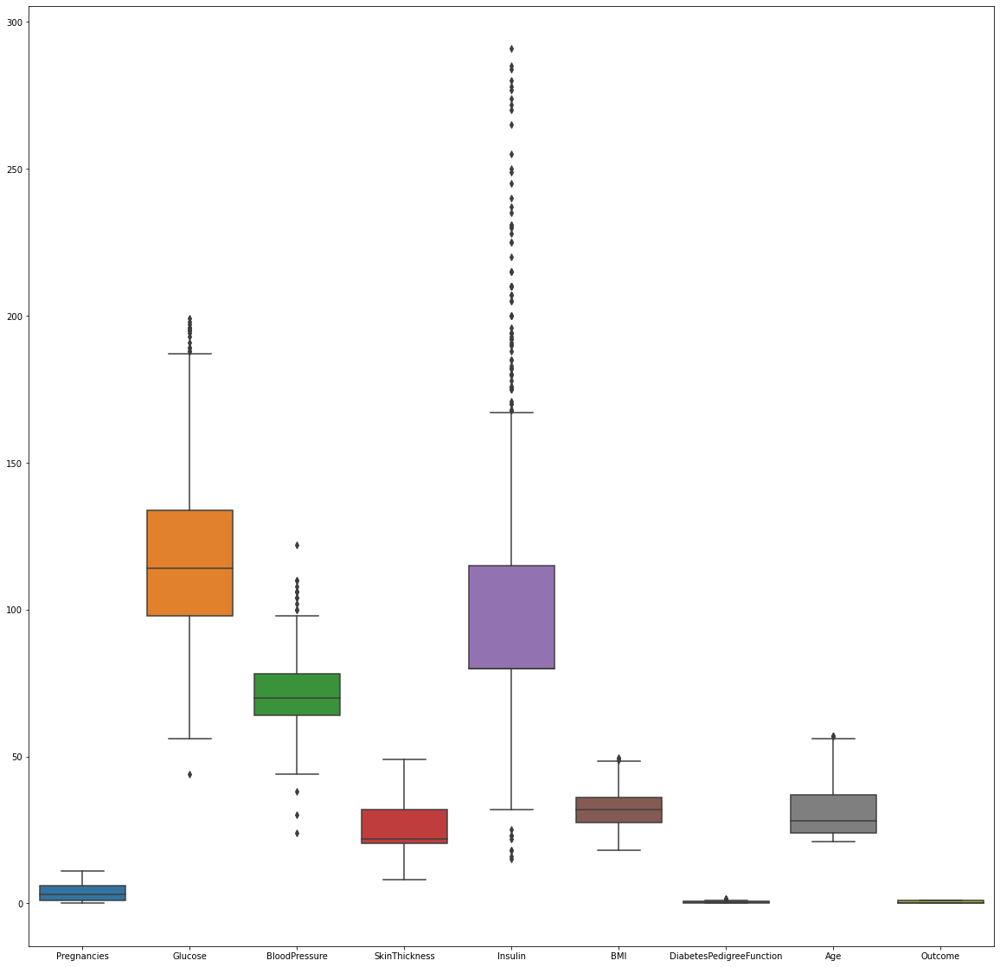

In [19]:
fig ,ax = plt.subplots(figsize = (20,20))
sns.boxplot(data=df_new, ax=ax)

In [20]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


In [21]:
y = df_new['Outcome']
y

0      1
1      0
2      1
3      0
5      0
      ..
762    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 646, dtype: int64

In [22]:
x = df_new.drop(columns=['Outcome'])
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [28]:
#Standard Scaling
scaler = StandardScaler()
scaler.fit_transform(x)

array([[ 0.81816201,  1.01925342,  0.02462769, ...,  0.25624577,
         0.63386957,  1.99618647],
       [-0.84703225, -1.14931789, -0.48413665, ..., -0.84400099,
        -0.33994809, -0.02586459],
       [ 1.48423971,  2.22401526, -0.65372476, ..., -1.36268875,
         0.79264418,  0.08055915],
       ...,
       [ 0.48512315,  0.08986571,  0.02462769, ..., -0.90687223,
        -0.71395052, -0.13228833],
       [-0.84703225,  0.26197455, -0.99290098, ..., -0.29387761,
        -0.34700474,  1.67691525],
       [-0.84703225, -0.87394376, -0.14496043, ..., -0.24672418,
        -0.46696778, -0.87725451]])

In [29]:
ProfileReport(pd.DataFrame(scaler.fit_transform(x)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

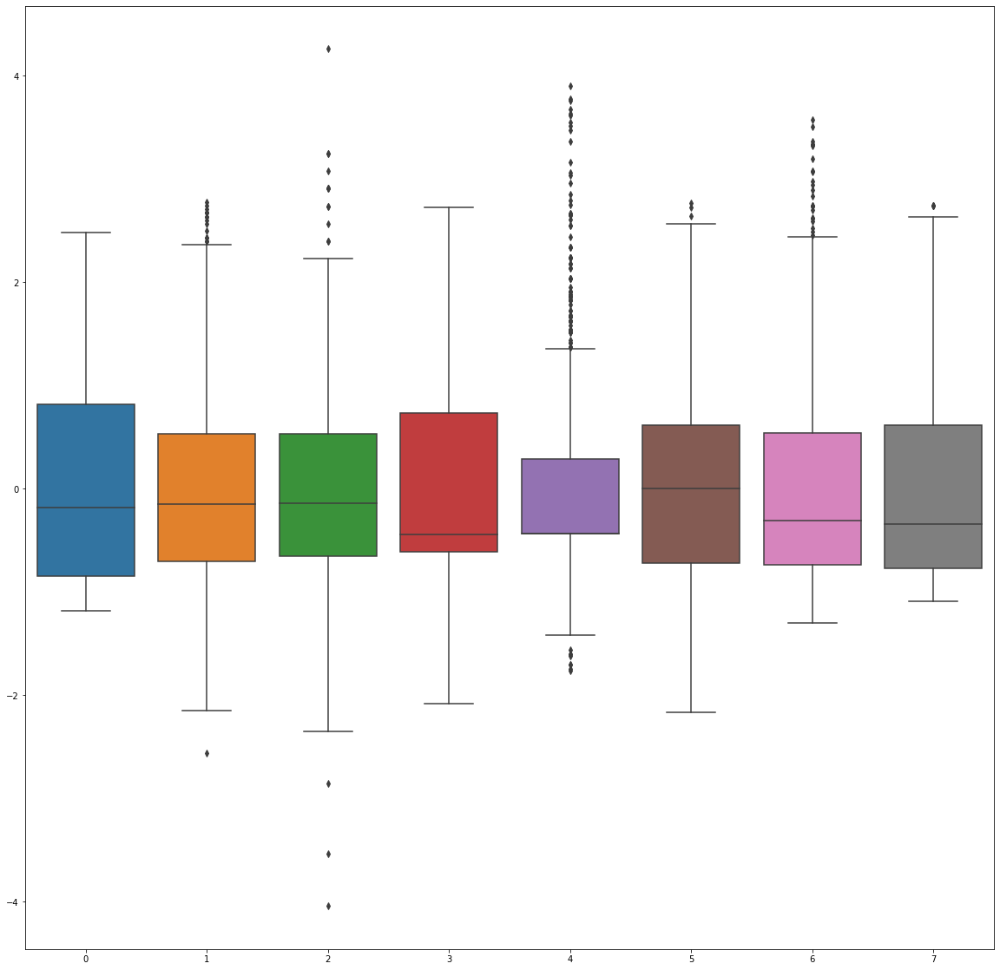

In [33]:
x_scaler = scaler.fit_transform(x)
fig ,ax = plt.subplots(figsize = (20,20))
sns.boxplot(data=x_scaler, ax=ax)

In [34]:
x_scaler

array([[ 0.81816201,  1.01925342,  0.02462769, ...,  0.25624577,
         0.63386957,  1.99618647],
       [-0.84703225, -1.14931789, -0.48413665, ..., -0.84400099,
        -0.33994809, -0.02586459],
       [ 1.48423971,  2.22401526, -0.65372476, ..., -1.36268875,
         0.79264418,  0.08055915],
       ...,
       [ 0.48512315,  0.08986571,  0.02462769, ..., -0.90687223,
        -0.71395052, -0.13228833],
       [-0.84703225,  0.26197455, -0.99290098, ..., -0.29387761,
        -0.34700474,  1.67691525],
       [-0.84703225, -0.87394376, -0.14496043, ..., -0.24672418,
        -0.46696778, -0.87725451]])

In [35]:
y

0      1
1      0
2      1
3      0
5      0
      ..
762    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 646, dtype: int64

In [40]:
def vif_score(x):
	scaler = StandardScaler()
	arr = scaler.fit_transform(x)
	return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns=[ "FEATURE", "VIF_SCORE"])

In [41]:
vif_score(x) #don't remove column unless vif score<10

,FEATURE,VIF_SCORE
0,Pregnancies,1.639791
1,Glucose,1.296328
2,BloodPressure,1.253942
3,SkinThickness,1.459561
4,Insulin,1.275985
5,BMI,1.507628
6,DiabetesPedigreeFunction,1.046682
7,Age,1.874682


In [42]:
#Train and Test Split
train_test_split(x_scaler , y , test_size = .20 , random_state = 144)


[array([[-0.84703225,  1.87979759,  0.1942158 , ...,  0.75921571,
         -1.26789752,  0.71910159],
        [-0.84703225, -0.35761725,  1.38133257, ..., -0.76541194,
         -0.16706017, -0.77083077],
        [ 0.1520843 , -0.08224312,  0.02462769, ..., -1.55130247,
          0.05522429,  0.61267785],
        ...,
        [-0.18095455,  2.49938939, -0.31454854, ..., -0.16813513,
         -0.52342098,  0.29340663],
        [-1.1800711 ,  0.29639631,  0.70298013, ...,  0.68062666,
          1.25838306, -0.87725451],
        [-0.5139934 ,  0.70945752,  0.27900985, ..., -1.0011791 ,
         -0.98915986, -0.23871207]]),
 array([[-0.84703225, -0.94278729, -1.50166531, ..., -1.06405034,
         -0.7527621 , -0.87725451],
        [ 2.48335626,  0.84714458,  1.8900969 , ...,  0.72778009,
         -0.6821956 ,  2.10261021],
        [-0.18095455,  0.19313101,  0.70298013, ...,  0.19337452,
         -0.50225103, -0.55798329],
        ...,
        [ 0.48512315,  0.15870925,  0.1942158 , ...,  

In [43]:
x_train, x_test, y_train, y_test = train_test_split(x_scaler , y , test_size = .20 , random_state = 144)

In [44]:
x_train

array([[-0.84703225,  1.87979759,  0.1942158 , ...,  0.75921571,
        -1.26789752,  0.71910159],
       [-0.84703225, -0.35761725,  1.38133257, ..., -0.76541194,
        -0.16706017, -0.77083077],
       [ 0.1520843 , -0.08224312,  0.02462769, ..., -1.55130247,
         0.05522429,  0.61267785],
       ...,
       [-0.18095455,  2.49938939, -0.31454854, ..., -0.16813513,
        -0.52342098,  0.29340663],
       [-1.1800711 ,  0.29639631,  0.70298013, ...,  0.68062666,
         1.25838306, -0.87725451],
       [-0.5139934 ,  0.70945752,  0.27900985, ..., -1.0011791 ,
        -0.98915986, -0.23871207]])

In [45]:
x_test

array([[-0.84703225, -0.94278729, -1.50166531, ..., -1.06405034,
        -0.7527621 , -0.87725451],
       [ 2.48335626,  0.84714458,  1.8900969 , ...,  0.72778009,
        -0.6821956 ,  2.10261021],
       [-0.18095455,  0.19313101,  0.70298013, ...,  0.19337452,
        -0.50225103, -0.55798329],
       ...,
       [ 0.48512315,  0.15870925,  0.1942158 , ...,  0.33483482,
        -0.62927073, -0.34513581],
       [ 0.81816201, -0.46088256, -0.14496043, ..., -0.18385294,
        -1.14793448,  0.61267785],
       [-0.18095455, -0.97720906,  0.53339202, ...,  1.68656655,
         0.39394348, -1.09010199]])

In [47]:
logr = LogisticRegression(verbose=1)

In [48]:
logr.fit(x_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


LogisticRegression(verbose=1)

In [55]:
x_test[1]

array([ 2.48335626,  0.84714458,  1.8900969 ,  0.84915121,  0.9234132 ,
        0.72778009, -0.6821956 ,  2.10261021])

In [56]:
logr.predict([x_test[1]])

array([1], dtype=int64)

In [57]:
logr.predict_proba([x_test[1]])

array([[0.27305212, 0.72694788]])

In [58]:
logr.predict_log_proba([x_test[1]])

array([[-1.29809258, -0.3189005 ]])

In [59]:
y_test.iloc[1]

1

In [60]:
logr_liblinear = LogisticRegression(verbose=1, solver='liblinear')

In [61]:
logr_liblinear.fit(x_train, y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [62]:
logr_liblinear.predict(x_test)

array([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0],
      dtype=int64)

In [63]:
y_pred_liblinear = logr_liblinear.predict(x_test)

In [64]:
y_pred_liblinear

array([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0],
      dtype=int64)

In [65]:
y_pred_default = logr.predict(x_test)

In [66]:
y_pred_default

array([0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 1,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0],
      dtype=int64)

In [67]:
confusion_matrix(y_test, y_pred_liblinear)

array([[78,  8],
       [18, 26]], dtype=int64)

In [68]:
confusion_matrix(y_test, y_pred_default)

array([[79,  7],
       [18, 26]], dtype=int64)

In [73]:
def model_eval(y_true,y_pred):
    tn, fp, fn, tp = confusion_matrix(y_test,y_pred).ravel()
    accuracy=(tp+tn)/(tp+tn+fp+fn)
    precision=tp/(tp+fp)
    recall=tp/(tp+fn)
    specificity=tn/(fp+tn)
    result={"Accuracy":accuracy, "Precision" :precision, "Recall" :recall, "Specificity" :specificity}
    return result

model_eval (y_test, y_pred_liblinear)

{'Accuracy': 0.8,
 'Precision': 0.7647058823529411,
 'Recall': 0.5909090909090909,
 'Specificity': 0.9069767441860465}

In [74]:
model_eval (y_test, y_pred_default)

{'Accuracy': 0.8076923076923077,
 'Precision': 0.7878787878787878,
 'Recall': 0.5909090909090909,
 'Specificity': 0.9186046511627907}

In [75]:
roc_auc_score(y_test, y_pred_liblinear)

0.7489429175475687

In [76]:
roc_auc_score(y_test, y_pred_default)

0.7547568710359408

In [77]:
roc_curve(y_test, y_pred_liblinear)

(array([0.        , 0.09302326, 1.        ]),
 array([0.        , 0.59090909, 1.        ]),
 array([2, 1, 0], dtype=int64))

In [85]:
auc = roc_auc_score(y_test, y_pred_liblinear)

In [86]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_liblinear)

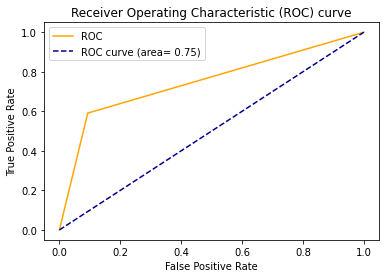

In [87]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color= 'darkblue', linestyle='--', label='ROC curve (area= %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) curve')
plt.legend()
plt.show()